In [1]:
import torch
import cv2 
from matplotlib import pyplot as plt
import os
import numpy as np
import PIL
from PIL import Image
os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"  # Arrange GPU devices starting from 0
os.environ["CUDA_VISIBLE_DEVICES"]= "1"  # Set the GPU 1 to use

In [2]:
from data.core.data_loader import load_whole_image 
data_path = "data/Samsung_SNU"
num_per_Ffolder = 16
whole_images = load_whole_image(data_path,num_per_Ffolder)

=== extracting [SET 1] ===
data/Samsung_SNU/[SET 1]/F32
data/Samsung_SNU/[SET 1]/F8
data/Samsung_SNU/[SET 1]/F64
data/Samsung_SNU/[SET 1]/F16
=== extracting [SET 2] ===
data/Samsung_SNU/[SET 2]/F32
data/Samsung_SNU/[SET 2]/F8
data/Samsung_SNU/[SET 2]/F64
data/Samsung_SNU/[SET 2]/F16
=== extracting [SET 3] ===
data/Samsung_SNU/[SET 3]/F32
data/Samsung_SNU/[SET 3]/F8
data/Samsung_SNU/[SET 3]/F64
data/Samsung_SNU/[SET 3]/F16
=== extracting [SET 4] ===
data/Samsung_SNU/[SET 4]/F32
data/Samsung_SNU/[SET 4]/F8
data/Samsung_SNU/[SET 4]/F64
data/Samsung_SNU/[SET 4]/F16


In [3]:
print("=== dict structure ===")
sub_dict = whole_images
while(True):
    try :
        for keys in sub_dict.keys():
            print(keys, end=", ")
        sub_dict = sub_dict[keys]
        print("")
    except : 
        break

=== dict structure ===
[SET 1], [SET 2], [SET 3], [SET 4], 
F32, F8, F64, F16, 
1_F16.png, 2_F16.png, 3_F16.png, 4_F16.png, 5_F16.png, 6_F16.png, 7_F16.png, 8_F16.png, 9_F16.png, 10_F16.png, 11_F16.png, 12_F16.png, 13_F16.png, 14_F16.png, 15_F16.png, 16_F16.png, 


In [4]:
diff8_64 = whole_images['[SET 1]']['F8']['1_F8.png'] - whole_images['[SET 1]']['F64']['1_F64.png']
diff16_64 = whole_images['[SET 1]']['F16']['1_F16.png'] - whole_images['[SET 1]']['F64']['1_F64.png']
diff32_64 = whole_images['[SET 1]']['F32']['1_F32.png'] - whole_images['[SET 1]']['F64']['1_F64.png']

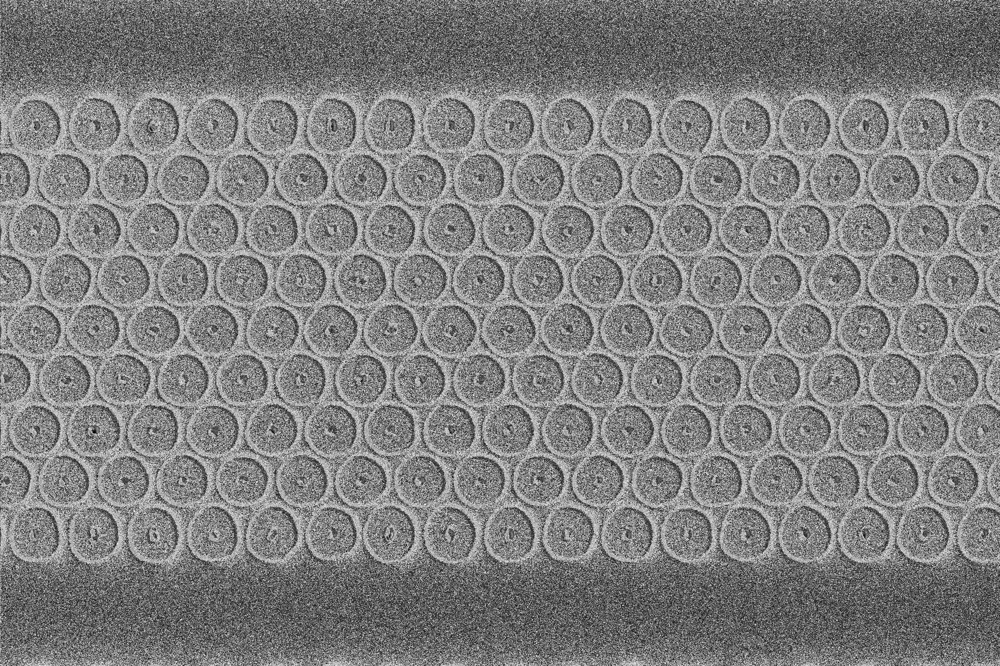

In [5]:
PIL.Image.fromarray(diff8_64)

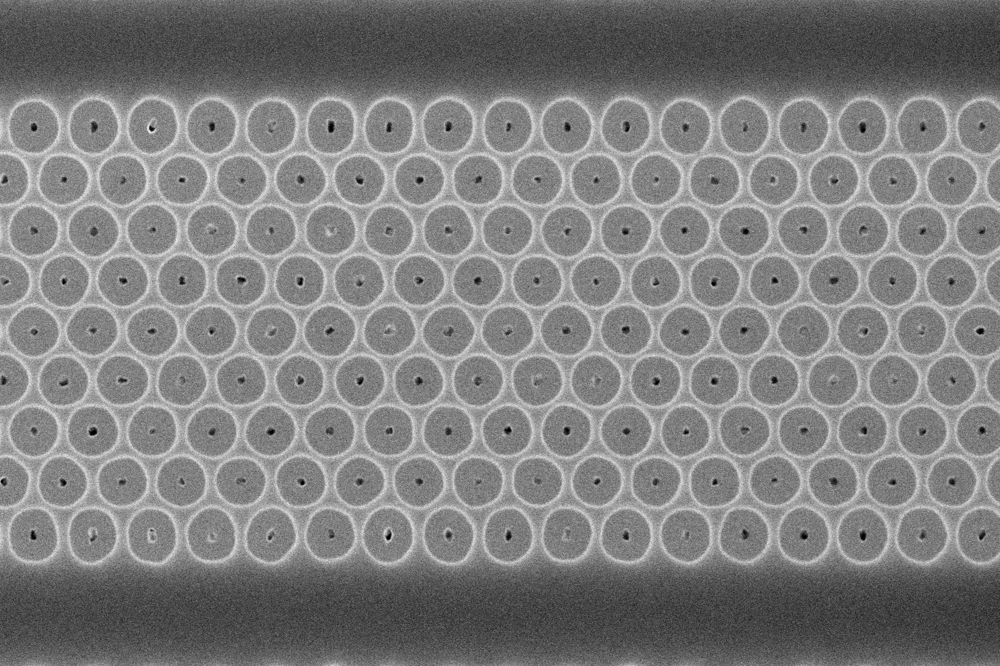

In [6]:
PIL.Image.fromarray(whole_images['[SET 1]']['F16']['1_F16.png'])

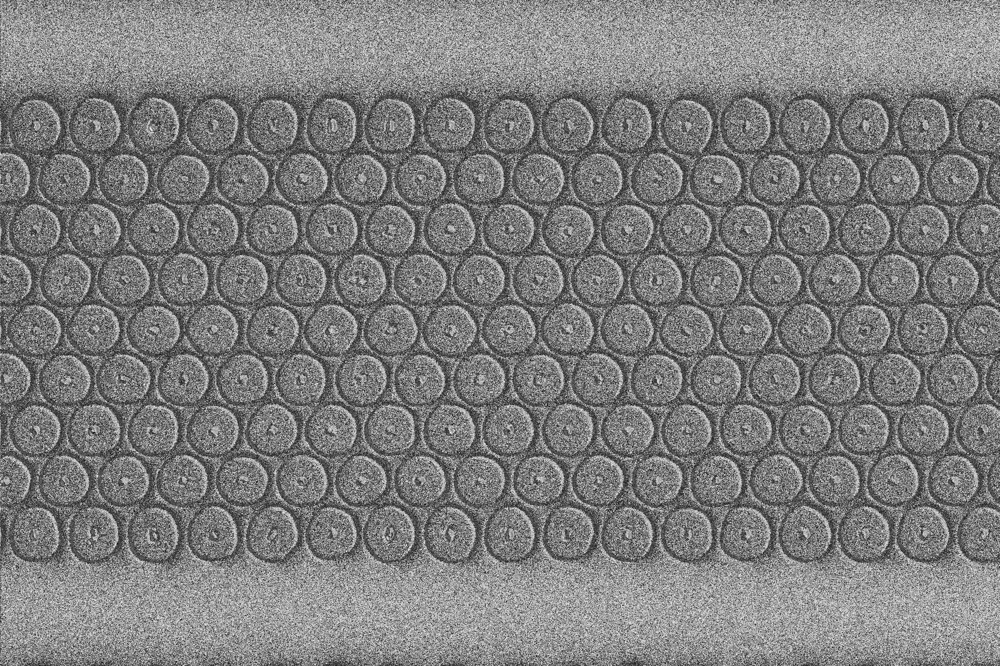

In [7]:
diff64_8 = whole_images['[SET 1]']['F64']['1_F64.png'] - whole_images['[SET 1]']['F8']['1_F8.png'] 
PIL.Image.fromarray(diff64_8)

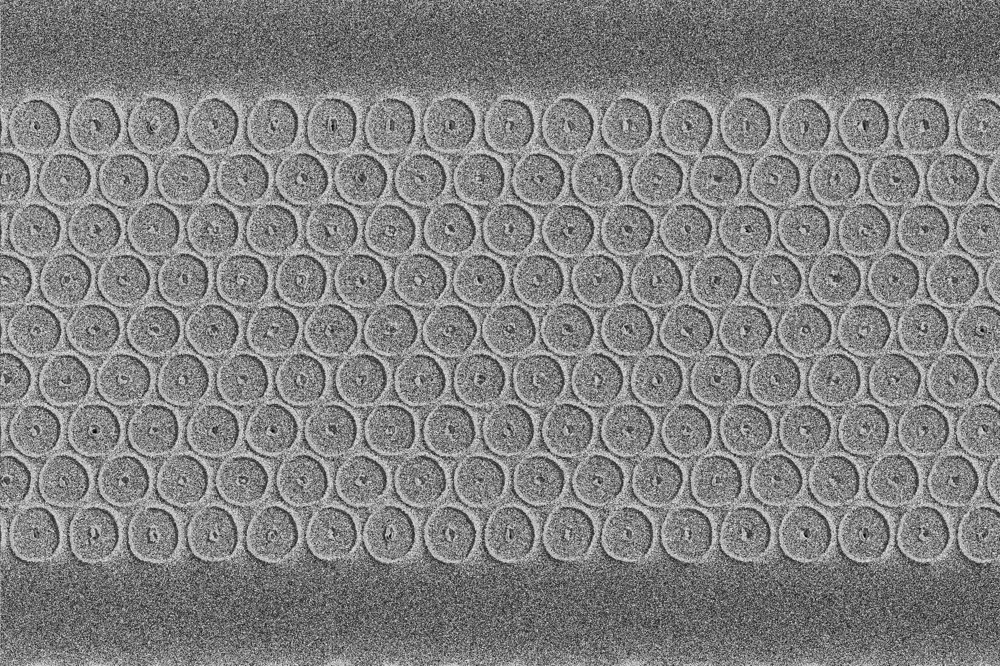

In [8]:
PIL.Image.fromarray(diff16_64)

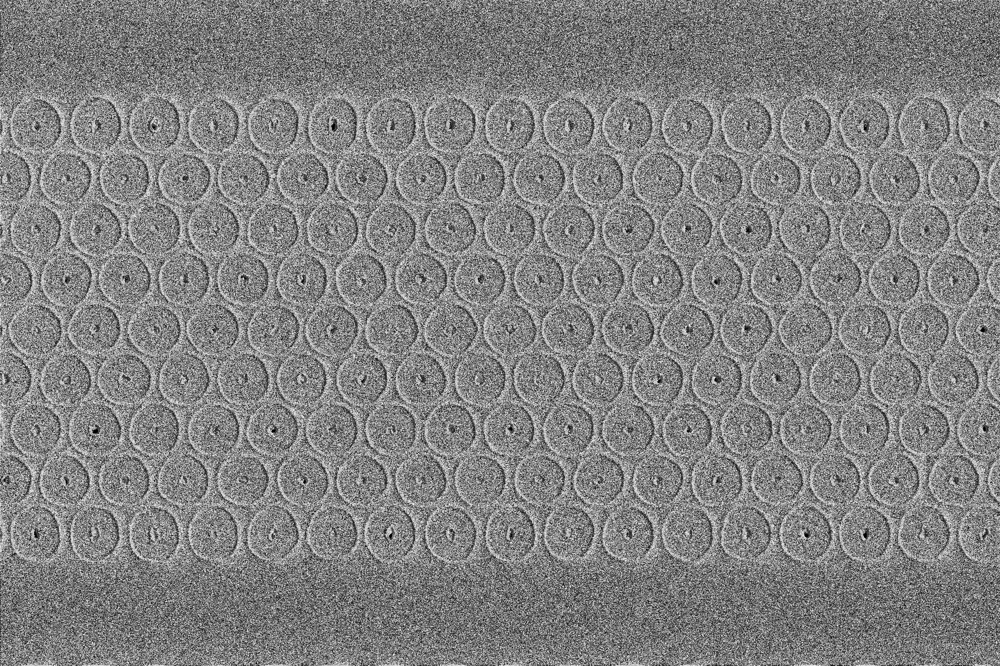

In [9]:
PIL.Image.fromarray(diff32_64)

In [5]:
np.unique(diff8_64)

array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
       104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
       117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
       130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
       143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155,
       156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168,
       169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 18

In [18]:
(whole_images['[SET 1]']['F8']['1_F8.png']).astype('uint16').max()

255

In [11]:
diff8_64 = whole_images['[SET 1]']['F8']['1_F8.png'].astype('float') \
            - whole_images['[SET 1]']['F64']['1_F64.png'].astype('float')
diff8_64.min(), diff8_64.max()

(-255.0, 255.0)

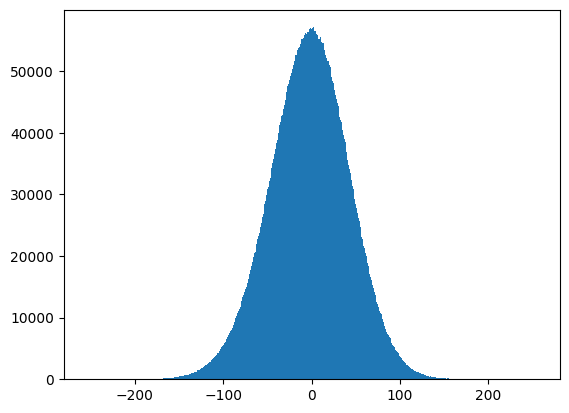

In [13]:
bins = np.linspace(-255,255,512)
plt.hist(diff8_64.flatten(),bins)
plt.show()

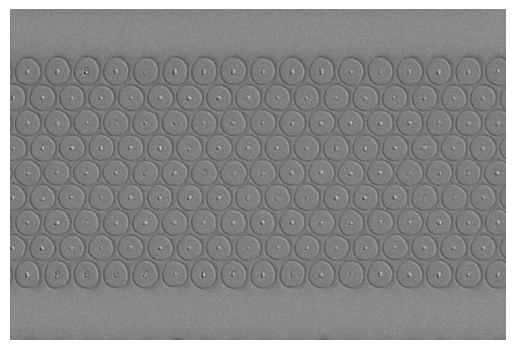

In [24]:
# not rescale
plt.axis('off')
plt.imshow(diff8_64,cmap='gray')
plt.savefig('./data/diff8_64.png',dpi=3000)

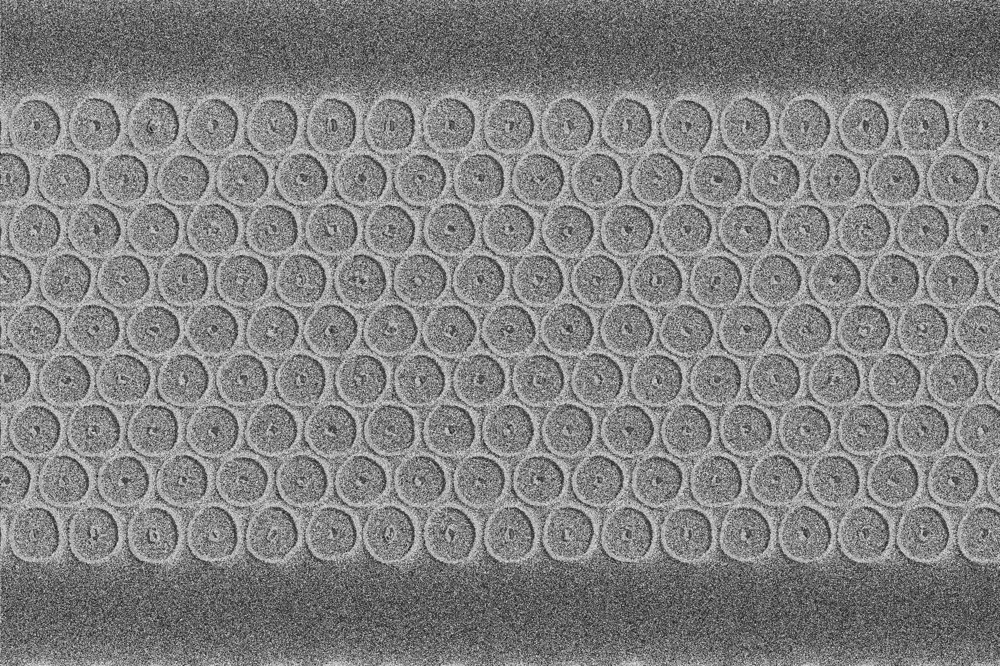

In [21]:
diff8_64 = diff8_64 + 255
PIL.Image.fromarray(diff8_64.astype('uint8'))

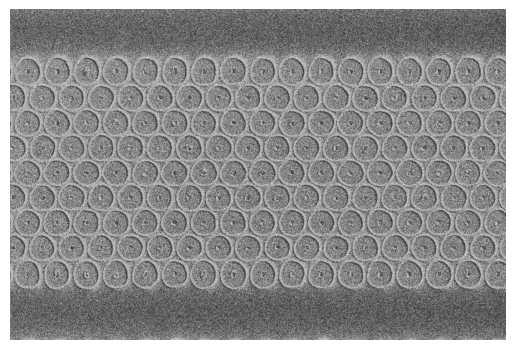

In [23]:
plt.axis('off')
plt.imshow(diff8_64.astype('uint8'),cmap='gray')

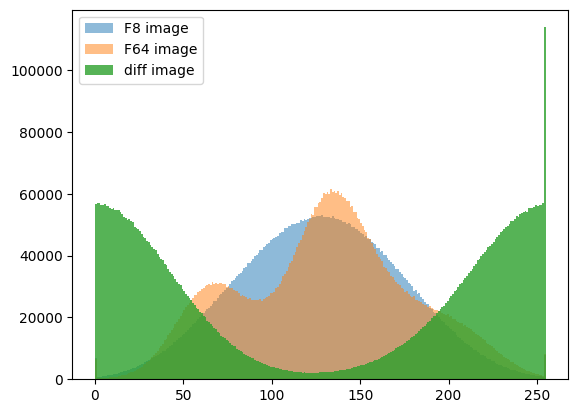

In [32]:
plt.hist(whole_images['[SET 1]']['F8']['1_F8.png'].flatten(),bins,alpha=0.5,label='F8 image')
plt.hist(whole_images['[SET 1]']['F64']['1_F64.png'].flatten(),bins,alpha=0.5,label='F64 image')
plt.hist(diff8_64.flatten(),bins,alpha=0.8,label='diff image')
plt.legend()
plt.show()

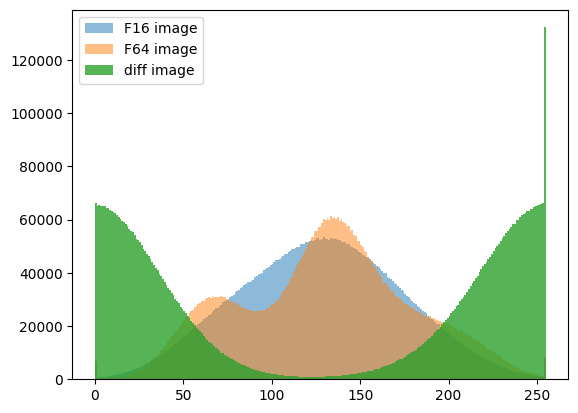

In [39]:
plt.hist(whole_images['[SET 1]']['F16']['1_F16.png'].flatten(),bins,alpha=0.5,label='F16 image')
plt.hist(whole_images['[SET 1]']['F64']['1_F64.png'].flatten(),bins,alpha=0.5,label='F64 image')
plt.hist(diff16_64.flatten(),bins,alpha=0.8,label='diff image')
plt.legend()
plt.show()

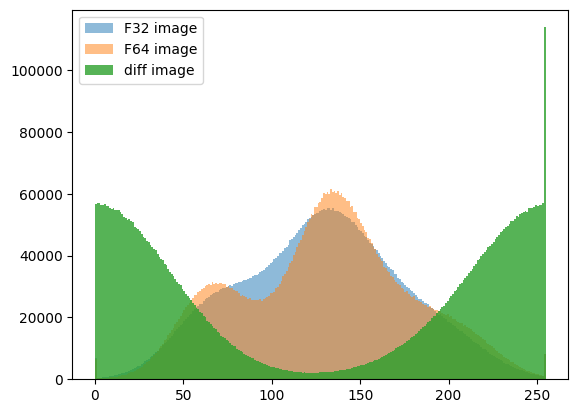

In [38]:
plt.hist(whole_images['[SET 1]']['F32']['1_F32.png'].flatten(),bins,alpha=0.5,label='F32 image')
plt.hist(whole_images['[SET 1]']['F64']['1_F64.png'].flatten(),bins,alpha=0.5,label='F64 image')
plt.hist(diff32_64.flatten(),bins,alpha=0.8,label='diff image')
plt.legend()
plt.show()